# Load & process data

In [1]:
# import torch geometric via pip wheels
import argparse
import os
import time
import networkx as nx
import torch
import torch.optim as optim
from torch_geometric.datasets import TUDataset
from torch_geometric.datasets import Planetoid
from torch_geometric.data import DataLoader
import torch_geometric.nn as pyg_nn
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.sparse as sp
from torch_geometric.utils import to_networkx
import collections
from tqdm import tqdm

/Users/elisa.gomezdelope/opt/anaconda3/envs/py-pytorch/lib/python3.7/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Load PPI from STRING

In [2]:
# get human PPI network/graph from downloaded file

ppi_file = "../../../references/9606.protein.links.detailed.v12.0.txt"
data = pd.read_csv(ppi_file, sep=' ')
alias_file = "../../../references/9606.protein.aliases.v12.0.txt"
alias = pd.read_csv(alias_file, sep='\t')

In [3]:
alias

,#string_protein_id,alias,source
0,9606.ENSP00000000233,2B6H,Ensembl_PDB
1,9606.ENSP00000000233,2B6H,UniProt_DR_PDB
2,9606.ENSP00000000233,381,Ensembl_HGNC_entrez_id
3,9606.ENSP00000000233,381,KEGG_GENEID
4,9606.ENSP00000000233,381,KEGG_KEGGID_SHORT
...,...,...,...
3889202,9606.ENSP00000501317,regulatory factor X domain containing 2,Ensembl_HGNC_prev_name
3889203,9606.ENSP00000501317,"regulatory factor X, 7",Ensembl_HGNC_prev_name
3889204,9606.ENSP00000501317,regulatory factor X7,Ensembl_HGNC_name
3889205,9606.ENSP00000501317,uc059jng.1,Ensembl_HGNC_ucsc_id


In [4]:
data

,protein1,protein2,neighborhood,fusion,cooccurence,coexpression,experimental,database,textmining,combined_score
0,9606.ENSP00000000233,9606.ENSP00000356607,0,0,0,45,134,0,81,173
1,9606.ENSP00000000233,9606.ENSP00000427567,0,0,0,0,128,0,70,154
2,9606.ENSP00000000233,9606.ENSP00000253413,0,0,0,118,49,0,69,151
3,9606.ENSP00000000233,9606.ENSP00000493357,0,0,0,56,53,0,457,471
4,9606.ENSP00000000233,9606.ENSP00000324127,0,0,0,0,46,0,197,201
...,...,...,...,...,...,...,...,...,...,...
13715399,9606.ENSP00000501317,9606.ENSP00000475489,0,0,0,60,99,0,126,195
13715400,9606.ENSP00000501317,9606.ENSP00000370447,0,0,0,55,111,0,79,158
13715401,9606.ENSP00000501317,9606.ENSP00000312272,0,0,0,0,0,0,227,226
13715402,9606.ENSP00000501317,9606.ENSP00000402092,0,0,0,0,67,0,146,169


In [5]:
# Prune the network to get only edges with high confidence score
min_score = 700 # Minimum confidence score to keep an edge
n = data.shape[0]
data = data.loc[data['combined_score']>= min_score]
nf = data.shape[0]
print("Protein-Protein edges included: " + str(nf) + "/" + str(n) + " (" + str(round(nf/n * 100, 2))+ " %)")

Protein-Protein edges included: 473860/13715404 (3.45 %)


In [6]:
# find Ensembl protein id - gene id mappings
alias = alias.loc[alias["source"] == "Ensembl_gene"]

In [7]:
# translate protein1
data = data.merge(alias, left_on='protein1', right_on='#string_protein_id', how='left').drop(['#string_protein_id', 'source'], axis=1)
data.rename(columns={'alias': 'gene1'}, inplace = True)

In [8]:
# translate protein2
data = data.merge(alias, left_on='protein2', right_on='#string_protein_id', how='left').drop(['#string_protein_id', 'source'], axis=1)
data.rename(columns={'alias': 'gene2'}, inplace = True)

In [9]:
data

,protein1,protein2,neighborhood,fusion,cooccurence,coexpression,experimental,database,textmining,combined_score,gene1,gene2
0,9606.ENSP00000000233,9606.ENSP00000158762,0,0,0,47,91,0,814,825,ENSG00000004059,ENSG00000072818
1,9606.ENSP00000000233,9606.ENSP00000357048,0,0,0,79,271,500,260,718,ENSG00000004059,ENSG00000122218
2,9606.ENSP00000000233,9606.ENSP00000262305,0,0,0,0,663,0,866,952,ENSG00000004059,ENSG00000090565
3,9606.ENSP00000000233,9606.ENSP00000329419,0,0,0,89,298,500,316,752,ENSG00000004059,ENSG00000184432
4,9606.ENSP00000000233,9606.ENSP00000469035,0,0,0,335,268,500,259,795,ENSG00000004059,ENSG00000105669
...,...,...,...,...,...,...,...,...,...,...,...,...
473855,9606.ENSP00000501277,9606.ENSP00000326630,0,0,0,62,89,0,938,942,ENSG00000198728,ENSG00000179588
473856,9606.ENSP00000501277,9606.ENSP00000263726,0,0,0,62,843,500,339,944,ENSG00000198728,ENSG00000121454
473857,9606.ENSP00000501317,9606.ENSP00000290524,0,0,0,74,618,0,431,780,ENSG00000181827,ENSG00000143390
473858,9606.ENSP00000501317,9606.ENSP00000305071,0,0,0,0,965,0,386,978,ENSG00000181827,ENSG00000064490


In [10]:
ppi_score = data[["gene1", "gene2", "combined_score"]]
ppi_score.loc[:,"combined_score"] = ppi_score.loc[:,"combined_score"]/1000 # scale values between 0 and 1

/Users/elisa.gomezdelope/opt/anaconda3/envs/py-pytorch/lib/python3.7/site-packages/pandas/core/indexing.py:1773: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


In [11]:
ppi_score

,gene1,gene2,combined_score
0,ENSG00000004059,ENSG00000072818,0.825
1,ENSG00000004059,ENSG00000122218,0.718
2,ENSG00000004059,ENSG00000090565,0.952
3,ENSG00000004059,ENSG00000184432,0.752
4,ENSG00000004059,ENSG00000105669,0.795
...,...,...,...
473855,ENSG00000198728,ENSG00000179588,0.942
473856,ENSG00000198728,ENSG00000121454,0.944
473857,ENSG00000181827,ENSG00000143390,0.780
473858,ENSG00000181827,ENSG00000064490,0.978


In [12]:
# check whether links are unique or duplicate
ppi_score[(ppi_score["gene1"] == "ENSG00000004059") | (ppi_score["gene2"] == "ENSG00000004059")]

,gene1,gene2,combined_score
0,ENSG00000004059,ENSG00000072818,0.825
1,ENSG00000004059,ENSG00000122218,0.718
2,ENSG00000004059,ENSG00000090565,0.952
3,ENSG00000004059,ENSG00000184432,0.752
4,ENSG00000004059,ENSG00000105669,0.795
5,ENSG00000004059,ENSG00000134287,0.756
6,ENSG00000004059,ENSG00000101199,0.795
7,ENSG00000004059,ENSG00000156675,0.755
8,ENSG00000004059,ENSG00000108669,0.765
9,ENSG00000004059,ENSG00000144711,0.835


In [12]:
print(len(ppi_score.gene1.unique()))
print(len(ppi_score.gene2.unique()))

16201
16201


Edges are duplicated.

### Load gene expression from PPMI


In [13]:
## PPMI data pre-processed 
# load gene expression
rnaseq_file = "../data/data_expr_4ML_DIAGNOSIS.tsv"
rnaseq = pd.read_csv(rnaseq_file, sep='\t')
print(rnaseq.shape)

# filter genes existing in rnaseq and STRINGdb
print(len(ppi_score.gene1.unique()))
print(len(ppi_score.gene2.unique()))
print(len(rnaseq.columns.unique()))

genes = np.intersect1d(ppi_score.gene1.unique(), 
                       np.intersect1d(ppi_score.gene2.unique(), 
                                      rnaseq.columns)
                      ).tolist()
print(len(genes)) # overall common genes

# subset those common genes that link with common genes
ppi_score = ppi_score.loc[ppi_score["gene1"].isin(genes)]
ppi_score = ppi_score.loc[ppi_score["gene2"].isin(genes)]
selected_columns = ['SAMPLE_ID'] + list(set(list(rnaseq.columns.unique())).intersection(list(ppi_score.gene1.unique()))) + ['DIAGNOSIS']
rnaseq = rnaseq[selected_columns]

print(len(ppi_score.gene1.unique()))
print(len(ppi_score.gene2.unique()))
print(len(rnaseq.columns.unique()))

(579, 14550)
16201
16201
14550
6588
6001
6001
6003


In [14]:
# labels
labels_file = "../data/labels_4ML.csv"
if os.path.exists(labels_file):
    print("Labels file exists.")
    labels = pd.read_csv(labels_file, sep = ",") 
else:
    print("Labels file does not exist ---> generating it!")
    labels = rnaseq[["SAMPLE_ID", "DIAGNOSIS"]]
    labels.to_csv("../data/labels_4ML.csv", index=False)

Labels file exists.


In [15]:
ids = np.intersect1d(rnaseq["SAMPLE_ID"],labels["SAMPLE_ID"])
if not (len(rnaseq["SAMPLE_ID"]) == len(labels.iloc[:,0].values) == len(ids)):
    labels = labels[labels["SAMPLE_ID"].isin(ids)]
    rnaseq = rnaseq[rnaseq["SAMPLE_ID"].isin(ids)]
rnaseq.drop(["DIAGNOSIS"], axis=1, inplace=True)

### Filter fully connected component

After mapping of 14,550 genes from the PPMI to the vertices of the PPI (16,201 initial nodes with known ENSEMBL_gene id and >=700 confidence score), the resulting PPI graph consisted of 6001 vertices (mapped genes). How are they distriuted? are they connected? 

In [16]:
# let's generate an object with edges only (no edge attributes).
ppi = ppi_score[["gene1", "gene2"]]
ppi.shape

(92820, 2)

In [17]:
G = nx.from_pandas_edgelist(df=ppi, source = "gene1", target = "gene2")
print(nx.is_directed(G))
print(nx.is_connected(G))

False
False


In [18]:
Gcc = sorted(nx.connected_components(G), key=len, reverse=True)
G_components = [len(c) for c in Gcc]

In [19]:
# number of connected components
print(len(G_components))
# size of 20 largest connected components
print(G_components[0:20])
# frequency distribution of connected components
np.unique(G_components, return_counts=True)

65
[5848, 8, 6, 5, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2]


(array([   2,    3,    4,    5,    6,    8, 5848]),
 array([51,  8,  2,  1,  1,  1,  1]))

The resulting network has 65 connected components. The main connected component has 5848 vertices, and each of the other 64 components has from 2 to 8 vertices. There are 51 components of 2 nodes and 8 components of 3 nodes. For further analyses, we utilize only the main connected component of size 5848 since Graph-NN require the graph to be connected. 

In [20]:
Gcc[0]

{'ENSG00000137757',
 'ENSG00000170222',
 'ENSG00000037757',
 'ENSG00000187080',
 'ENSG00000157445',
 'ENSG00000125457',
 'ENSG00000131148',
 'ENSG00000166167',
 'ENSG00000115392',
 'ENSG00000095380',
 'ENSG00000090621',
 'ENSG00000086288',
 'ENSG00000151500',
 'ENSG00000141994',
 'ENSG00000065526',
 'ENSG00000140986',
 'ENSG00000268500',
 'ENSG00000149260',
 'ENSG00000213347',
 'ENSG00000166598',
 'ENSG00000145107',
 'ENSG00000154945',
 'ENSG00000170340',
 'ENSG00000100298',
 'ENSG00000214595',
 'ENSG00000121957',
 'ENSG00000188486',
 'ENSG00000050393',
 'ENSG00000124731',
 'ENSG00000101447',
 'ENSG00000136158',
 'ENSG00000025770',
 'ENSG00000138600',
 'ENSG00000142733',
 'ENSG00000010361',
 'ENSG00000204311',
 'ENSG00000112245',
 'ENSG00000121211',
 'ENSG00000140284',
 'ENSG00000011007',
 'ENSG00000096746',
 'ENSG00000163872',
 'ENSG00000213780',
 'ENSG00000115523',
 'ENSG00000116005',
 'ENSG00000086848',
 'ENSG00000143951',
 'ENSG00000183751',
 'ENSG00000164896',
 'ENSG00000140694',


In [21]:
G0 = G.subgraph(Gcc[0])

In [22]:
ppi_nx = nx.to_pandas_edgelist(G0, source='gene1', target='gene2')
print(ppi_nx.iloc[0:10,:])

             gene1            gene2
0  ENSG00000004059  ENSG00000105669
1  ENSG00000004059  ENSG00000103769
2  ENSG00000004059  ENSG00000149182
3  ENSG00000004059  ENSG00000168374
4  ENSG00000004059  ENSG00000153317
5  ENSG00000004059  ENSG00000131242
6  ENSG00000004059  ENSG00000242247
7  ENSG00000004059  ENSG00000164144
8  ENSG00000004059  ENSG00000147889
9  ENSG00000004059  ENSG00000132254


In [23]:
print(len(ppi_nx.gene1.unique()))
print(len(ppi_nx.gene2.unique()))

4217
5705


In [24]:
len(set([gene for gene in ppi_nx.gene1.unique()] + [gene for gene in ppi_nx.gene2.unique()]))

5848

In [25]:
ppi_nx[(ppi_nx["gene1"] == "ENSG00000004059") | (ppi_nx["gene2"] == "ENSG00000004059")]

,gene1,gene2
0,ENSG00000004059,ENSG00000105669
1,ENSG00000004059,ENSG00000103769
2,ENSG00000004059,ENSG00000149182
3,ENSG00000004059,ENSG00000168374
4,ENSG00000004059,ENSG00000153317
5,ENSG00000004059,ENSG00000131242
6,ENSG00000004059,ENSG00000242247
7,ENSG00000004059,ENSG00000164144
8,ENSG00000004059,ENSG00000147889
9,ENSG00000004059,ENSG00000132254


In [26]:
np.intersect1d(["ENSG00000004059"], rnaseq.columns)

array(['ENSG00000004059'], dtype=object)

In ppi_nx (derived from networkx object) edges are not duplicated.

In [27]:
# filter genes existing in rnaseq and the largest connected component (ppi)
genes_G0 = list(set([gene for gene in ppi_nx.gene1.unique()] + [gene for gene in ppi_nx.gene2.unique()]))
print(len(genes_G0))
print(len(rnaseq.columns.unique()))

genes = np.intersect1d(genes_G0, rnaseq.columns).tolist()
print(len(genes)) # overall common genes -> all should be included!

if len(genes) == len(genes_G0):
    # subset those common genes from rnaseq
    rnaseq.drop(columns=rnaseq.columns[1:].difference(genes_G0), inplace=True)
else:
    raise valueError('Genes in G0 missing from rnaseq matrix')


print(len(genes_G0))
print(len(rnaseq.columns.unique()))

5848
6002
5848
5848
5849


In [28]:
# subset G0 genes in ppi_score df
ppi_score = ppi_score.loc[ppi_score["gene1"].isin(genes_G0)]
ppi_score = ppi_score.loc[ppi_score["gene2"].isin(genes_G0)]
ppi = ppi_score[["gene1", "gene2"]]
print(len(ppi_score.gene1.unique()))
print(len(ppi_score.gene2.unique()))
print(ppi_score.shape)
print(ppi.shape)

5848
5848
(92598, 3)
(92598, 2)


### Export data

In [29]:
# export matching data
ppi_score.to_csv("../data/ppi_score_4ML.csv", index=False)
ppi.to_csv("../data/ppi_4ML.csv", index=False)
rnaseq.to_csv("../data/data_rnaseq_ppi_4ML.csv", index=False)


### Playing with data

In [30]:
# generate dictionary of rnaseq features
rnaseq.set_index('SAMPLE_ID', inplace=True)
rnaseq_dict = rnaseq.to_dict()

In [31]:
rnaseq.isnull().values.any()

False

In [32]:
# build graph
G=nx.from_pandas_edgelist(ppi_score, "gene1", "gene2", edge_attr=True) # combined_score is an edge attribute
G.remove_edges_from(nx.selfloop_edges(G)) # remove loops 
print(G.number_of_nodes())
print(G.number_of_edges())
print(G.is_directed())
print(nx.is_connected(G))

5848
46299
False
True


In [72]:
A_weight = nx.to_numpy_matrix(G, weight="combined_score")
A_unweight = nx.to_numpy_matrix(G)
nodes = list(G.nodes())
A_weight = pd.DataFrame(A_weight, columns=nodes, index=nodes)
A_unweight = pd.DataFrame(A_unweight, columns=nodes, index=nodes)

A_weight.to_csv("../data/A_ppi_weighted_4ML.csv", index=True, header=True)
#A_unweight.to_csv("../data/A_ppi_unweighted_4ML.csv", index=True, header=True)

In [33]:
# add gene expression as node attributes
print(rnaseq_t.shape)
print(len(set(rnaseq_dict.keys())))
nx.set_node_attributes(G, rnaseq_dict)  

NameError: name 'rnaseq_t' is not defined

In [85]:
node_attributes_dic = nx.get_node_attributes(G, "3000.BL")
print(node_attributes_dic["ENSG00000004059"])
print(len(G.nodes['ENSG00000000419'].keys()))


453.8014482759842
579


In [86]:
rnaseq_t.loc["3000.BL",:]["ENSG00000004059"]

453.8014482759842

In [87]:
rnaseq_dict

{'ENSG00000000003': {'3000.BL': 32.07077372975154,
  '3001.BL': 14.35528166811788,
  '3002.BL': 90.91512314101684,
  '3003.BL': 11.862616635508964,
  '3004.BL': 20.90172527746913,
  '3006.BL': 20.501234077382176,
  '3007.BL': 24.307071166863995,
  '3008.BL': 23.0767464039127,
  '3009.BL': 31.262478113751783,
  '3010.BL': 11.234222352754063,
  '3011.BL': 22.43682546702697,
  '3012.BL': 18.12923894376126,
  '3013.BL': 23.769386902450652,
  '3014.BL': 8.078753038967909,
  '3016.BL': 25.07111203463841,
  '3018.BL': 11.816243388415764,
  '3020.BL': 9.766565088694028,
  '3021.BL': 7.459737968064021,
  '3023.BL': 18.010897093587452,
  '3024.BL': 15.913564820984638,
  '3025.BL': 54.764069005940456,
  '3026.BL': 21.68231738978188,
  '3027.BL': 31.238036634318014,
  '3028.BL': 15.063356694083057,
  '3029.BL': 25.556332888271537,
  '3051.BL': 19.833259165198506,
  '3052.BL': 23.42404398250289,
  '3053.BL': 5.00190601572305,
  '3054.BL': 23.9765308820937,
  '3055.BL': 17.458426732284593,
  '3057.B

In [44]:
node_attributes_dic

{'ENSG00000004059': 453.8014482759842,
 'ENSG00000143761': 3605.556736567317,
 'ENSG00000120370': 287.03342488127623,
 'ENSG00000157869': 477.8545285732979,
 'ENSG00000134287': 1343.7654192765892,
 'ENSG00000107862': 1536.9918309983425,
 'ENSG00000090565': 468.2332964543724,
 'ENSG00000101199': 681.5039417572201,
 'ENSG00000168374': 1202.6540148656825,
 'ENSG00000008256': 186.81225697580268,
 'ENSG00000003056': 3429.167481053683,
 'ENSG00000197081': 43217.77290886993,
 'ENSG00000100083': 642.2172439382745,
 'ENSG00000125447': 991.7886775925664,
 'ENSG00000105355': 1203.4557842089264,
 'ENSG00000004478': 434.5589840381333,
 'ENSG00000264364': 3700.967288413327,
 'ENSG00000100030': 11690.598793837678,
 'ENSG00000131966': 846.6684264654406,
 'ENSG00000096384': 2185.623229682567,
 'ENSG00000169083': 42.49377519192078,
 'ENSG00000080824': 1581.8909142199946,
 'ENSG00000102882': 658.2526308031503,
 'ENSG00000104671': 125.07601754603098,
 'ENSG00000174842': 309.4829664921023,
 'ENSG0000019889

### Visual of a small subgraph

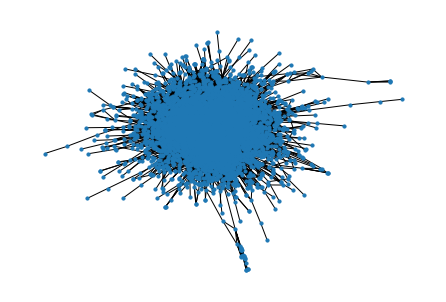

In [34]:
G=nx.from_pandas_edgelist(ppi_score, "gene1", "gene2", edge_attr=True)

# Plot it
nx.draw(G, with_labels=False, node_size = 10)
plt.show()

### Degree distribution and node centrality

,count,mean,std,min,25%,50%,75%,max
0,5848.0,15.83,21.06,1.0,3.0,8.0,19.0,191.0


5848
92598


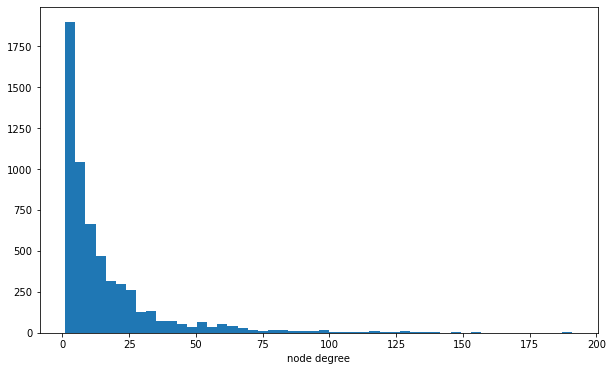

In [35]:
# degree distribution
degrees = [val for (node, val) in G.degree()]
display(pd.DataFrame(pd.Series(degrees).describe()).transpose().round(2))
print(len(degrees))
print(sum(degrees))
plt.figure(figsize=(10, 6))
plt.hist(degrees, bins=50)
plt.xlabel("node degree")
plt.show()

threshold 0.03371970495258166


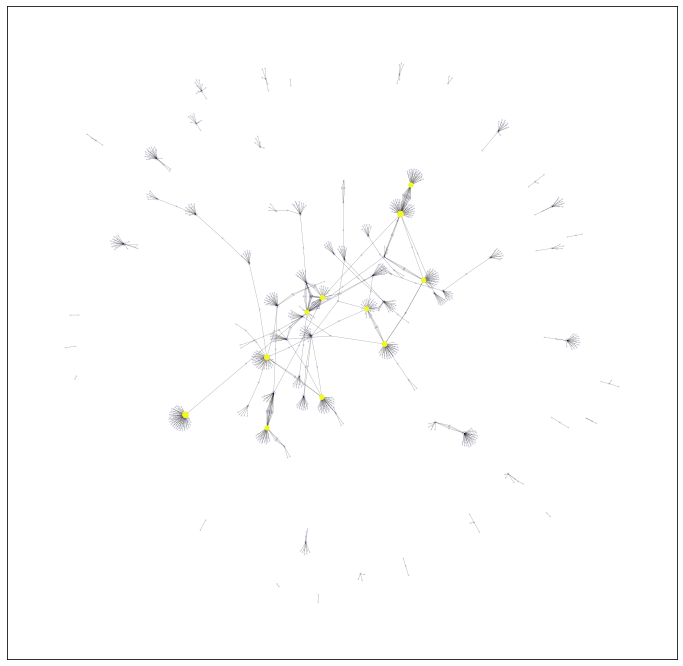

In [36]:
# node centrality
data3=ppi_score.iloc[0:1000,:] # let's pick a small subgraph for this
G3=nx.from_pandas_edgelist(data3, "gene1", "gene2", edge_attr=True)
pos = nx.spring_layout(G3, seed=42)
cent = nx.degree_centrality(G3)
node_size = list(map(lambda x: x * 500, cent.values()))
cent_array = np.array(list(cent.values()))
threshold = sorted(cent_array, reverse=True)[10]
print("threshold", threshold)
cent_bin = np.where(cent_array >= threshold, 1, 0.1)
plt.figure(figsize=(12, 12))
nodes = nx.draw_networkx_nodes(G3, pos, node_size=node_size,
                               cmap=plt.cm.plasma,
                               node_color=cent_bin,
                               nodelist=list(cent.keys()),
                               alpha=cent_bin)
edges = nx.draw_networkx_edges(G3, pos, width=0.25, alpha=0.5)
plt.show()

# Pytorch data generation

### Create Dataset of data objects: One graph (data) for each individual.

This type of structure is more useful for node classification problems, where there is only one graph 

From ppi data, we generate the edge_index of an undirected graph with edge attributes that maps to the node entities in the feature matrix X_df. This is basically the (fixed) structure of the ppi network.

From rnaseq data, we assign node feature values in each graph. We map the gene expression into the graph structure as a graph signal.

From phenotype data, we extract the labels of the graph, based on the diagnosis of each individual.

In [148]:
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader

In [149]:
### load data
# load gene expression
rnaseq_file = "../data/data_rnaseq_ppi.csv"
X_df = pd.read_csv(rnaseq_file, index_col=0)
#feature_values = rnaseq

# load ppi
ppi_file = "../data/ppi_score.csv"
ppi = pd.read_csv(ppi_file) #, index_col=0)

# load labels
pheno_file = "../data/labels.csv"
pheno = pd.read_csv(pheno_file, index_col=0)
labels_dict = dict(zip(labels.index, labels[labels.columns[0]]))

In [150]:
print(X_df.shape)
print(ppi.shape)
print(labels.shape)

(579, 12415)
(378212, 3)
(579, 2)


In [151]:
len(set([gene for gene in ppi.gene1.unique()] + [gene for gene in ppi.gene2.unique()]))

12415

In [193]:
from torch_geometric.data import InMemoryDataset

class MyOmicsDataset(InMemoryDataset):

    def __init__(self, root, X_file, graph_file, labels_file, transform=None, pre_transform=None, pre_filter=None): #
        self.X_file = X_file
        self.graph_file = graph_file
        self.labels_file = labels_file
        super(MyOmicsDataset, self).__init__(root, transform, pre_transform, pre_filter=None)
        self.data, self.slices = torch.load(self.processed_paths[0])
           
    @property
    def raw_file_names(self):
        """ If this file exists in raw_dir, the download is not triggered.
            (The download func. is not implemented here)  
        """
        return [self.X_file, self.graph_file, self.labels_file]

    @property
    def processed_file_names(self):
        """ If these files are found in processed_dir, processing is skipped"""
        return 'data.pt'

    def download(self):
        """ Download to `self.raw_dir`.
            Not implemented here
        """
        # path = download_url(url, self.raw_dir)
        pass

    def process(self):
        
        # load node attributes: gene expression
        X_df = pd.read_csv(self.raw_paths[0], index_col=0) # index is geneid

        # load graph: ppi
        ppi = pd.read_csv(self.raw_paths[1]) 
    
        # load labels
        labels = pd.read_csv(self.raw_paths[2], index_col=0)
        labels_dict = dict(zip(labels.index, labels[labels.columns[0]]))
        
        # convert df into tensors
        # map index to gene id in X_df -> {geneid: index} in node features
        X_mapping = {gene: i for i, gene in enumerate(X_df.columns)}
        src = [X_mapping[protein] for protein in ppi.iloc[:,0]] # get source nodes from first column
        dst = [X_mapping[protein] for protein in ppi.iloc[:,1]] # get destination nodes from second column
        edge_index = torch.tensor([src, dst])

        edge_attr = torch.tensor(ppi.iloc[:,2], dtype=torch.int) # get edge attributes from third column

        
        # create data objects
        data_list=[]
        
        for subject in tqdm(X_df.index.tolist()):
            ft = torch.tensor(X_df.loc[subject].astype(float).values, dtype=torch.float32).unsqueeze(1) # take the row corresponding for each subject (X_df: samples x genes] 
            label = labels_dict[subject] # take the value corresponding for each subject (labels_dict is {subject: label})
            graph = Data(x=ft, edge_index=edge_index, edge_attr=edge_attr, y=label) # edge_index values are corresponding to the index in the X_df matrix  , subject=subject 
            data_list.append(graph)
        
        
        # Apply the functions specified in pre_filter and pre_transform
        if self.pre_filter is not None:
            data_list = [data for data in data_list if self.pre_filter(data)]
        
        if self.pre_transform is not None: 
            data_list = [self.pre_transform(data) for data in data_list]
        
        # save processed data
        data, slices = self.collate(data_list)
        torch.save((data, slices), self.processed_paths[0])
         

#    def len(self):
#        return len(self.processed_file_names)
#
#    def get(self, idx):
#        data = torch.load(osp.join(self.processed_dir, 'data.pt'))
#        return data


In [198]:
dataset = MyOmicsDataset(root="../data", X_file="data_rnaseq_ppi.csv", graph_file="ppi_score.csv", labels_file="labels.csv")  

Processing...
100%|██████████| 579/579 [00:00<00:00, 1836.42it/s]


RuntimeError: [enforce fail at inline_container.cc:319] . unexpected pos 28754368 vs 28754308

In [154]:
dataset

MyOmicsDataset(578)

Dataloader is to be fed with data objects -> one data object per individual, where edge_index is the same -> shape between 2xnlinks, contain between 0 and m-1 ; then data.x would be the 1xm vector (m=number of genes); data.y = number (0/1) -> shape =1.


Our dataset should contain: 578 graphs, each with a label {0,1}, and a structure of 212546/2 edges.

In [145]:
print()
print(f'Dataset: {dataset}:')
print('====================')
print(f'Number of graphs: {len(dataset)}')
print(f'Number of features: {dataset.num_features}')
print(f'Number of classes: {dataset.num_classes}')


Dataset: MyOmicsDataset(578):
Number of graphs: 578
Number of features: 1
Number of classes: 2


In [146]:
# Get the first graph object.
data = dataset[0]  

print()
print(data)
print('=================================================================')

# Gather some statistics about the first graph.
print(f'Number of nodes: {data.num_nodes}')
print(f'Number of edges: {data.num_edges}')
print(f'Average node degree: {data.num_edges / data.num_nodes:.2f}')
print(f'Has isolated nodes: {data.has_isolated_nodes()}')
print(f'Has self-loops: {data.has_self_loops()}')
print(f'Is undirected: {data.is_undirected()}')


Data(x=[9390], edge_index=[2, 212134], edge_attr=[212134], y=[1])
Number of nodes: 9390
Number of edges: 212134
Average node degree: 22.59
Has isolated nodes: False
Has self-loops: False
Is undirected: True


In [147]:
from torch_geometric.utils import to_networkx
nx_G = to_networkx(data, node_attrs=["x"])
nx_G = nx.to_undirected(nx_G)
nx.is_connected(nx_G)

True

In [152]:
data.x

tensor([  899.9657, 10343.5326,   252.8738,  ...,  1784.4719,   242.9355,
           34.2318], dtype=torch.float64)